## Problem Statement 

You need to build a model that is able to classify customer complaints based on the products/services. By doing so, you can segregate these tickets into their relevant categories and, therefore, help in the quick resolution of the issue.

You will be doing topic modelling on the <b>.json</b> data provided by the company. Since this data is not labelled, you need to apply NMF to analyse patterns and classify tickets into the following five clusters based on their products/services:

* Credit card / Prepaid card

* Bank account services

* Theft/Dispute reporting

* Mortgages/loans

* Others 


With the help of topic modelling, you will be able to map each ticket onto its respective department/category. You can then use this data to train any supervised model such as logistic regression, decision tree or random forest. Using this trained model, you can classify any new customer complaint support ticket into its relevant department.

## Pipelines that needs to be performed:

You need to perform the following eight major tasks to complete the assignment:

1.  Data loading

2. Text preprocessing

3. Exploratory data analysis (EDA)

4. Feature extraction

5. Topic modelling 

6. Model building using supervised learning

7. Model training and evaluation

8. Model inference

## Importing the necessary libraries

In [87]:
import json 
import numpy as np
import pandas as pd
import re, nltk, spacy, string
import en_core_web_sm
nlp = en_core_web_sm.load()
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from plotly.offline import plot
import plotly.graph_objects as go
import plotly.express as px

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from pprint import pprint
from collections import Counter
from operator import itemgetter
from sklearn.model_selection import GridSearchCV

In [75]:
from bokeh.plotting import figure, output_file, show
from bokeh.models import Label
from bokeh.io import output_notebook
output_notebook()

%matplotlib inline

Loading BokehJS ...

## Loading the data

The data is in JSON format and we need to convert it to a dataframe.

In [2]:
# Opening JSON file 
f ='complaints-2021-05-14_08_16.json'
  
# returns JSON object as  
# a dictionary 
with open(f,'r') as file:
    data = json.load(file)
df=pd.json_normalize(data)

## Data preparation

In [3]:
# Inspect the dataframe to understand the given data.
df


,_index,_type,_id,_score,_source.tags,_source.zip_code,_source.complaint_id,_source.issue,_source.date_received,_source.state,...,_source.company_response,_source.company,_source.submitted_via,_source.date_sent_to_company,_source.company_public_response,_source.sub_product,_source.timely,_source.complaint_what_happened,_source.sub_issue,_source.consumer_consent_provided
0,complaint-public-v2,complaint,3211475,0.0,None,90301,3211475,Attempts to collect debt not owed,2019-04-13T12:00:00-05:00,CA,...,Closed with explanation,JPMORGAN CHASE & CO.,Web,2019-04-13T12:00:00-05:00,None,Credit card debt,Yes,,Debt is not yours,Consent not provided
1,complaint-public-v2,complaint,3229299,0.0,Servicemember,319XX,3229299,Written notification about debt,2019-05-01T12:00:00-05:00,GA,...,Closed with explanation,JPMORGAN CHASE & CO.,Web,2019-05-01T12:00:00-05:00,None,Credit card debt,Yes,Good morning my name is XXXX XXXX and I apprec...,Didn't receive enough information to verify debt,Consent provided
2,complaint-public-v2,complaint,3199379,0.0,None,77069,3199379,"Other features, terms, or problems",2019-04-02T12:00:00-05:00,TX,...,Closed with explanation,JPMORGAN CHASE & CO.,Web,2019-04-02T12:00:00-05:00,None,General-purpose credit card or charge card,Yes,I upgraded my XXXX XXXX card in XX/XX/2018 and...,Problem with rewards from credit card,Consent provided
3,complaint-public-v2,complaint,2673060,0.0,None,48066,2673060,Trouble during payment process,2017-09-13T12:00:00-05:00,MI,...,Closed with explanation,JPMORGAN CHASE & CO.,Web,2017-09-14T12:00:00-05:00,None,Conventional home mortgage,Yes,,None,Consent not provided
4,complaint-public-v2,complaint,3203545,0.0,None,10473,3203545,Fees or interest,2019-04-05T12:00:00-05:00,NY,...,Closed with explanation,JPMORGAN CHASE & CO.,Referral,2019-04-05T12:00:00-05:00,None,General-purpose credit card or charge card,Yes,,Charged too much interest,N/A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78308,complaint-public-v2,complaint,3105617,0.0,None,08857,3105617,Closing an account,2018-12-20T12:00:00-05:00,NJ,...,Closed with explanation,JPMORGAN CHASE & CO.,Web,2018-12-21T12:00:00-05:00,None,Checking account,Yes,,Funds not received from closed account,Consent not provided
78309,complaint-public-v2,complaint,3091984,0.0,None,934XX,3091984,"Other features, terms, or problems",2018-12-05T12:00:00-05:00,CA,...,Closed with monetary relief,JPMORGAN CHASE & CO.,Web,2018-12-05T12:00:00-05:00,None,General-purpose credit card or charge card,Yes,"On Wednesday, XX/XX/XXXX I called Chas, my XXX...",Other problem,Consent provided
78310,complaint-public-v2,complaint,3133355,0.0,None,923XX,3133355,Problem with a lender or other company chargin...,2019-01-25T12:00:00-05:00,CA,...,Closed with explanation,JPMORGAN CHASE & CO.,Web,2019-01-25T12:00:00-05:00,None,Checking account,Yes,I am not familiar with XXXX pay and did not un...,Transaction was not authorized,Consent provided
78311,complaint-public-v2,complaint,3110963,0.0,None,None,3110963,"Other features, terms, or problems",2018-12-27T12:00:00-05:00,PA,...,Closed with monetary relief,JPMORGAN CHASE & CO.,Web,2018-12-27T12:00:00-05:00,None,General-purpose credit card or charge card,Yes,I have had flawless credit for 30 yrs. I've ha...,Problem with balance transfer,Consent provided


In [4]:
#print the column names
df.columns

Index(['_index', '_type', '_id', '_score', '_source.tags', '_source.zip_code',
       '_source.complaint_id', '_source.issue', '_source.date_received',
       '_source.state', '_source.consumer_disputed', '_source.product',
       '_source.company_response', '_source.company', '_source.submitted_via',
       '_source.date_sent_to_company', '_source.company_public_response',
       '_source.sub_product', '_source.timely',
       '_source.complaint_what_happened', '_source.sub_issue',
       '_source.consumer_consent_provided'],
      dtype='object')

In [5]:
#Assign new column names
columnns_names=['index', 'type', 'id', 'score', 'tags', 'zip_code',
       'complaint_id', 'issue', 'date_received',
       'state', 'consumer_disputed', 'product',
       'company_response', 'company', 'submitted_via',
       'date_sent_to_company', 'company_public_response',
       'sub_product', 'timely',
       'complaint_what_happened', 'sub_issue',
       'consumer_consent_provided']
df.columns=columnns_names

In [6]:
#Assign nan in place of blanks in the complaints column
(df.isnull().sum()/len(df))*100

index                         0.000000
type                          0.000000
id                            0.000000
score                         0.000000
tags                         86.081493
zip_code                      8.628197
complaint_id                  0.000000
issue                         0.000000
date_received                 0.000000
state                         2.542362
consumer_disputed             0.000000
product                       0.000000
company_response              0.000000
company                       0.000000
submitted_via                 0.000000
date_sent_to_company          0.000000
company_public_response      99.994892
sub_product                  13.498397
timely                        0.000000
complaint_what_happened       0.000000
sub_issue                    59.117899
consumer_consent_provided     1.287143
dtype: float64

In [7]:
Columns_Null=[columns for columns in columnns_names if df[columns].isnull().sum()>0]

In [8]:
df[Columns_Null].nunique()

tags                            3
zip_code                     9442
state                          62
company_public_response         3
sub_product                    72
sub_issue                     205
consumer_consent_provided       5
dtype: int64

In [9]:
for columns in Columns_Null:
    print(columns,df[columns].unique())

tags [None 'Servicemember' 'Older American' 'Older American, Servicemember']
zip_code ['90301' '319XX' '77069' ... '27539' '48455' '93268']
state ['CA' 'GA' 'TX' 'MI' 'NY' 'NJ' 'IL' 'WA' 'KY' 'LA' 'IN' 'FL' 'MD' 'UT'
 'AL' 'NE' 'MA' 'NC' None 'NV' 'AZ' 'WI' 'OH' 'MN' 'OK' 'TN' 'AP' 'VA'
 'CO' 'PA' 'CT' 'SC' 'MO' 'AE' 'IA' 'NM' 'DC' 'OR' 'WV' 'AR' 'ID' 'RI'
 'NH' 'MT' 'ME' 'KS' 'PR' 'MS' 'DE' 'HI' 'VT' 'AK' 'ND' 'SD' 'WY'
 'UNITED STATES MINOR OUTLYING ISLANDS' 'MH' 'AA' 'VI' 'GU' 'FM' 'AS' 'PW']
company_public_response [None
 'Company believes complaint relates to a discontinued policy or procedure'
 'Company has responded to the consumer and the CFPB and chooses not to provide a public response'
 'Company chooses not to provide a public response']
sub_product ['Credit card debt' 'General-purpose credit card or charge card'
 'Conventional home mortgage' 'Checking account'
 'Other personal consumer report' 'Credit reporting'
 'Other type of mortgage' 'Loan' 'Domestic (US) money transfer

In [10]:
df[columnns_names]=df[columnns_names].replace(r'^\s*$',np.nan,regex=True)


In [11]:
(df.isnull().sum()/len(df))*100

index                         0.000000
type                          0.000000
id                            0.000000
score                         0.000000
tags                         86.081493
zip_code                      8.628197
complaint_id                  0.000000
issue                         0.000000
date_received                 0.000000
state                         2.542362
consumer_disputed             0.000000
product                       0.000000
company_response              0.000000
company                       0.000000
submitted_via                 0.000000
date_sent_to_company          0.000000
company_public_response      99.994892
sub_product                  13.498397
timely                        0.000000
complaint_what_happened      73.092590
sub_issue                    59.117899
consumer_consent_provided     1.287143
dtype: float64

In [12]:
#Remove all rows where complaints column is nan
df.shape

(78313, 22)

In [13]:
df_clean=df.copy()

In [14]:
df_clean=df_clean.dropna(subset=['complaint_what_happened'])

In [15]:
df_clean.shape

(21072, 22)

In [16]:
df_clean=df_clean.drop('tags',axis=1)

In [17]:
df_clean=df_clean.drop('zip_code',axis=1)

In [18]:
df_clean=df_clean.drop('company_public_response',axis=1)

In [19]:
(df_clean.isnull().sum()/len(df_clean))*100

index                         0.000000
type                          0.000000
id                            0.000000
score                         0.000000
complaint_id                  0.000000
issue                         0.000000
date_received                 0.000000
state                         0.678626
consumer_disputed             0.000000
product                       0.000000
company_response              0.000000
company                       0.000000
submitted_via                 0.000000
date_sent_to_company          0.000000
sub_product                  10.008542
timely                        0.000000
complaint_what_happened       0.000000
sub_issue                    38.800304
consumer_consent_provided     0.000000
dtype: float64

In [20]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 21072 entries, 1 to 78312
Data columns (total 19 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   index                      21072 non-null  object 
 1   type                       21072 non-null  object 
 2   id                         21072 non-null  object 
 3   score                      21072 non-null  float64
 4   complaint_id               21072 non-null  object 
 5   issue                      21072 non-null  object 
 6   date_received              21072 non-null  object 
 7   state                      20929 non-null  object 
 8   consumer_disputed          21072 non-null  object 
 9   product                    21072 non-null  object 
 10  company_response           21072 non-null  object 
 11  company                    21072 non-null  object 
 12  submitted_via              21072 non-null  object 
 13  date_sent_to_company       21072 non-null  object 


## Prepare the text for topic modeling

Once you have removed all the blank complaints, you need to:

* Make the text lowercase
* Remove text in square brackets
* Remove punctuation
* Remove words containing numbers


Once you have done these cleaning operations you need to perform the following:
* Lemmatize the texts
* Extract the POS tags of the lemmatized text and remove all the words which have tags other than NN[tag == "NN"].


In [21]:
# Write your function here to clean the text and remove all the unnecessary elements.
import re
def clean_text(text):
    text=text.lower()
    text=re.sub(r'\[.*?\]','',text)
    text=re.sub(r'[^\w\s]','',text)
    text = re.sub(r'\b\w*\d\w*\b', '', text)
    text = re.sub(r'\s+', ' ', text).strip()
    return text
    

In [25]:
from IPython.display import display
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [22]:
df_clean['complaint_what_happened']=df_clean['complaint_what_happened'].apply(clean_text)

In [23]:
tokenized_complain=df_clean['complaint_what_happened'].apply(lambda x: x.split())

In [28]:
tokenized_complain.head()

1     [good, morning, my, name, is, xxxx, xxxx, and,...
2     [i, upgraded, my, xxxx, xxxx, card, in, and, w...
10    [chase, card, was, reported, on, however, frau...
11    [on, while, trying, to, book, a, xxxx, xxxx, t...
14    [my, grand, son, give, me, check, for, i, depo...
Name: complaint_what_happened, dtype: object

In [32]:
df_clean.loc[:,('complaint_what_happened')]


1        good morning my name is xxxx xxxx and i apprec...
2        i upgraded my xxxx xxxx card in and was told b...
10       chase card was reported on however fraudulent ...
11       on while trying to book a xxxx xxxx ticket i c...
14       my grand son give me check for i deposit it in...
15                           can you please remove inquiry
17       with out notice jp morgan chase restricted my ...
20       during the summer months i experience a declin...
21       on xxxx i made a payment to an online retailer...
23       i have a chase credit card which is incorrectl...
24       mishandling of this account by chase auto and ...
26       i have reached out to xxxx several times in at...
27       i opened an account with chase bank on xxxx an...
30       to whom it may concern chase bank charged wron...
32       my chase amazon card was declined for a cateri...
35       i opened the saving account for the bonus i wa...
40       xxxx xxxx a sofa love seat table and chairs an.

In [33]:
df_clean.drop_duplicates(subset=['complaint_what_happened'],keep='first',inplace=True)

In [35]:
df_clean.reset_index(drop=True,inplace=True)

In [36]:
df_clean.shape

(20871, 19)

In [37]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20871 entries, 0 to 20870
Data columns (total 19 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   index                      20871 non-null  object 
 1   type                       20871 non-null  object 
 2   id                         20871 non-null  object 
 3   score                      20871 non-null  float64
 4   complaint_id               20871 non-null  object 
 5   issue                      20871 non-null  object 
 6   date_received              20871 non-null  object 
 7   state                      20730 non-null  object 
 8   consumer_disputed          20871 non-null  object 
 9   product                    20871 non-null  object 
 10  company_response           20871 non-null  object 
 11  company                    20871 non-null  object 
 12  submitted_via              20871 non-null  object 
 13  date_sent_to_company       20871 non-null  obj

In [44]:
#Write your function to Lemmatize the texts
import spacy
nlp = spacy.load("en_core_web_sm")
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
from nltk.stem import WordNetLemmatizer 
le=WordNetLemmatizer()
def clean_and_lemmatize(text):
    # Lemmatize using spaCy
    word_tokens  = nltk.word_tokenize(text)
    tokens       = [le.lemmatize(w) for w in word_tokens if w not in stop_words and len(w)>3]
    cleaned_text =" ".join(tokens)
    return cleaned_text


In [45]:
df_clean['lemmatized_complaints']=df_clean['complaint_what_happened'].apply(clean_and_lemmatize)

In [46]:
df_clean=df_clean[['complaint_what_happened','lemmatized_complaints']]

In [47]:
#Create a dataframe('df_clean') that will have only the complaints and the lemmatized complaints 
df_clean

,complaint_what_happened,lemmatized_complaints
0,good morning my name is xxxx xxxx and i apprec...,good morning name xxxx xxxx appreciate could h...
1,i upgraded my xxxx xxxx card in and was told b...,upgraded xxxx xxxx card told agent upgrade ann...
2,chase card was reported on however fraudulent ...,chase card reported however fraudulent applica...
3,on while trying to book a xxxx xxxx ticket i c...,trying book xxxx xxxx ticket came across offer...
4,my grand son give me check for i deposit it in...,grand give check deposit chase account fund cl...
5,can you please remove inquiry,please remove inquiry
6,with out notice jp morgan chase restricted my ...,notice morgan chase restricted account debit c...
7,during the summer months i experience a declin...,summer month experience decline income employm...
8,on xxxx i made a payment to an online retailer...,xxxx made payment online retailer using chase ...
9,i have a chase credit card which is incorrectl...,chase credit card incorrectly reporting data c...


## Exploratory data analysis to get familiar with the data.

Write the code in this task to perform the following:

*   Visualise the data according to the 'Complaint' character length
*   Using a word cloud find the top 40 words by frequency among all the articles after processing the text
*   Find the top unigrams,bigrams and trigrams by frequency among all the complaints after processing the text. ‘




In [ ]:
# Write your code here to visualise the data according to the 'Complaint' character length

#### Find the top 40 words by frequency among all the articles after processing the text.

In [48]:
#Using a word cloud find the top 40 words by frequency among all the articles after processing the text
def get_top_n_words(n_top_words, count_vectorizer, text_data):
    '''
    returns a tuple of the top n words in a sample and their 
    accompanying counts, given a CountVectorizer object and text sample
    '''
    vectorized_headlines = count_vectorizer.fit_transform(text_data.values)
    vectorized_total = np.sum(vectorized_headlines, axis=0)
    word_indices = np.flip(np.argsort(vectorized_total)[0,:], 1)
    word_values = np.flip(np.sort(vectorized_total)[0,:],1)
    
    word_vectors = np.zeros((n_top_words, vectorized_headlines.shape[1]))
    for i in range(n_top_words):
        word_vectors[i,word_indices[0,i]] = 1

    words = [word[0].encode('ascii').decode('utf-8') for 
             word in count_vectorizer.inverse_transform(word_vectors)]

    return (words, word_values[0,:n_top_words].tolist()[0])

def get_keys(topic_matrix):
    '''
    returns an integer list of predicted topic 
    categories for a given topic matrix
    '''
    keys = topic_matrix.argmax(axis=1).tolist()
    return keys

def keys_to_counts(keys):
    '''
    returns a tuple of topic categories and their 
    accompanying magnitudes for a given list of keys
    '''
    count_pairs = Counter(keys).items()
    categories = [pair[0] for pair in count_pairs]
    counts = [pair[1] for pair in count_pairs]
    return (categories, counts)

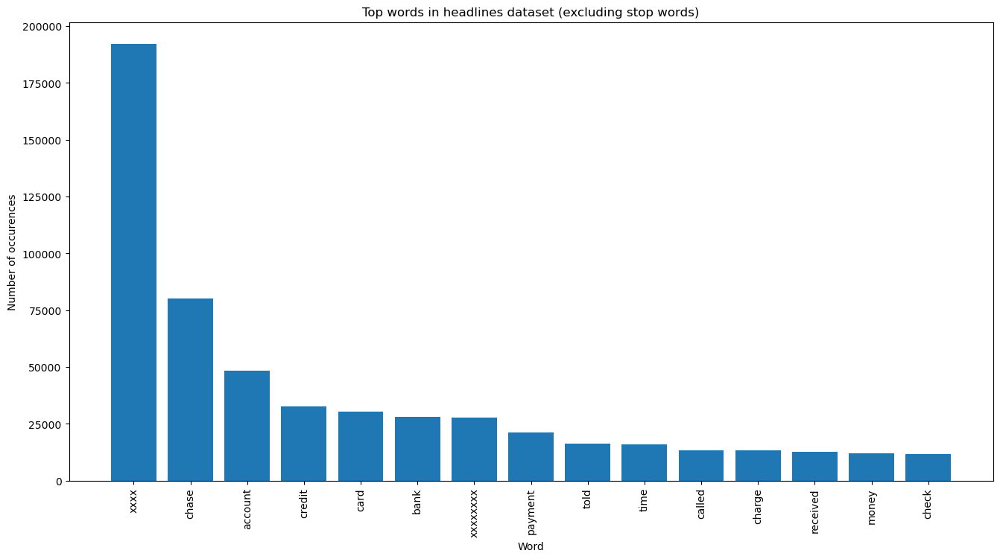

In [49]:
count_vectorizer = CountVectorizer(stop_words='english')
words, word_values = get_top_n_words(n_top_words=15,
                                     count_vectorizer=count_vectorizer, 
                                     text_data=df_clean['lemmatized_complaints'])

fig, ax = plt.subplots(figsize=(16,8))
ax.bar(range(len(words)), word_values);
ax.set_xticks(range(len(words)));
ax.set_xticklabels(words, rotation='vertical');
ax.set_title('Top words in headlines dataset (excluding stop words)');
ax.set_xlabel('Word');
ax.set_ylabel('Number of occurences');
plt.show()

In [54]:
!pip install textblob

Defaulting to user installation because normal site-packages is not writeable
  Obtaining dependency information for textblob from https://files.pythonhosted.org/packages/02/07/5fd2945356dd839974d3a25de8a142dc37293c21315729a41e775b5f3569/textblob-0.18.0.post0-py3-none-any.whl.metadata
   ---------------------------------------- 0.0/626.3 kB ? eta -:--:--
   ---- ----------------------------------- 71.7/626.3 kB 1.9 MB/s eta 0:00:01
   ------------------- -------------------- 307.2/626.3 kB 3.8 MB/s eta 0:00:01
   ---------------------------------------  624.6/626.3 kB 4.4 MB/s eta 0:00:01
   ---------------------------------------- 626.3/626.3 kB 4.4 MB/s eta 0:00:00


DEPRECATION: ansys-dpf-core 0.8.1 has a non-standard dependency specifier ansys-dpf-gate>=0.3.*. pip 23.3 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of ansys-dpf-core or contact the author to suggest that they release a version with a conforming dependency specifiers. Discussion can be found at https://github.com/pypa/pip/issues/12063


In [55]:
from textblob import TextBlob
def stats_of_documents(data_df):
    
    data = data_df['lemmatized_complaints'].tolist()
    tagged_headlines = [TextBlob(data[i]).pos_tags for i in range(len(data))]
    
    tagged_headlines_df = pd.DataFrame({'tags':tagged_headlines})

    word_counts = [] 
    pos_counts = {}

    for headline in tagged_headlines_df[u'tags']:
        word_counts.append(len(headline))
        for tag in headline:
            if tag[1] in pos_counts:
                pos_counts[tag[1]] += 1
            else:
                pos_counts[tag[1]] = 1

    print('Total number of words: ', np.sum(word_counts))
    print('Mean number of words per headline: ', np.mean(word_counts))
    print('Minimum number of words per headline: ', np.min(word_counts))
    print('Maximum number of words per headline: ', np.max(word_counts))

    pos_sorted_types = sorted(pos_counts, key=pos_counts.__getitem__, reverse=True)
    pos_sorted_counts = sorted(pos_counts.values(), reverse=True)

    fig, ax = plt.subplots(figsize=(18,8))
    ax.bar(range(len(pos_counts)), pos_sorted_counts);
    ax.set_xticks(range(len(pos_counts)));
    ax.set_xticklabels(pos_sorted_types);
    ax.set_title('Part-of-Speech Tagging for Headlines Corpus');
    ax.set_xlabel('Type of Word');


Total number of words:  2394332
Mean number of words per headline:  114.72052129749413
Minimum number of words per headline:  0
Maximum number of words per headline:  3030


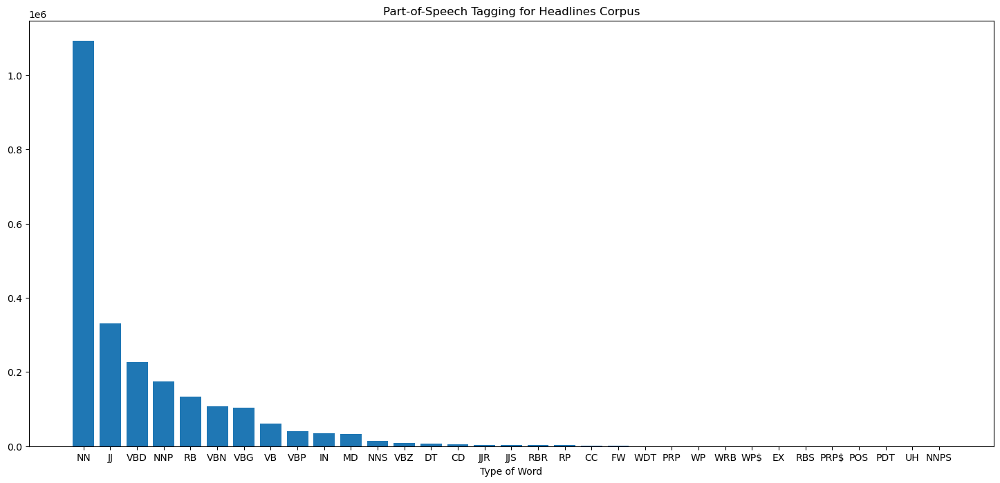

In [56]:
stats_of_documents(df_clean)

In [ ]:
#Removing -PRON- from the text corpus
df_clean['Complaint_clean'] = df_clean['complaint_POS_removed'].str.replace('-PRON-', '')

In [57]:
vect        = TfidfVectorizer(stop_words=stop_words,max_features=4000)
vect_text   = vect.fit_transform(df_clean['lemmatized_complaints'])

In [59]:
from sklearn.decomposition import NMF, LatentDirichletAllocation, TruncatedSVD
lsa_model = TruncatedSVD(n_components=10, algorithm='randomized', n_iter=10, random_state=42)

lsa_top   = lsa_model.fit_transform(vect_text)

In [60]:
l=lsa_top[1]
print("Document 0 :")
for i,topic in enumerate(l):
    print(i,topic)

Document 0 :
0 0.19660711461890895
1 0.0401308769573422
2 0.014040858292957935
3 -0.011676399274487551
4 -0.034222172607444694
5 0.05210075372559228
6 0.07342641427367531
7 0.004226301641822561
8 0.10385107264385732
9 -0.021088968716044314


In [61]:
def topics_document(model_output, n_topics , data):
    '''
    returns a dataframe for each document having topic weightages
    and the dominant topic for each doc. 
    '''
    
    # column names
    topicnames = ["Topic" + str(i) for i in range(n_topics)]
    # index names
    docnames = ["Doc" + str(i) for i in range(len(data))]
    # Make the pandas dataframe
    df_document_topic = pd.DataFrame(np.round(model_output, 2), columns=topicnames, index=docnames)
    # Get dominant topic for each document
    dominant_topic = np.argmax(df_document_topic.values, axis=1)
    df_document_topic["dominant_topic"] = dominant_topic
    
    return df_document_topic

In [63]:
documet_topic_lsa = topics_document(lsa_top, n_topics=10, data=df_clean['lemmatized_complaints'])
documet_topic_lsa

,Topic0,Topic1,Topic2,Topic3,Topic4,Topic5,Topic6,Topic7,Topic8,Topic9,dominant_topic
Doc0,0.33,0.08,-0.02,0.01,0.05,-0.01,-0.06,-0.04,-0.03,0.01,0
Doc1,0.20,0.04,0.01,-0.01,-0.03,0.05,0.07,0.00,0.10,-0.02,0
Doc2,0.10,-0.10,0.10,-0.08,0.02,0.04,-0.05,-0.03,-0.01,0.02,0
Doc3,0.29,-0.15,0.07,-0.05,0.02,0.05,-0.13,0.01,0.06,-0.05,0
Doc4,0.26,-0.14,-0.27,-0.00,0.07,0.03,-0.03,0.21,-0.06,0.07,0
Doc5,0.05,-0.02,0.14,-0.07,0.18,0.24,0.03,0.06,-0.15,0.05,5
Doc6,0.22,-0.21,-0.16,0.04,0.04,0.01,0.00,0.00,0.00,-0.01,0
Doc7,0.25,-0.02,0.04,0.16,-0.01,0.00,-0.05,-0.01,-0.01,-0.09,0
Doc8,0.34,-0.08,-0.08,-0.03,-0.14,0.11,-0.10,-0.03,-0.11,-0.12,0
Doc9,0.14,-0.16,0.25,-0.11,0.12,0.05,-0.04,0.02,-0.07,0.01,2


In [66]:
lsa_keys = get_keys(lsa_top)
lsa_categories, lsa_counts = keys_to_counts(lsa_keys)

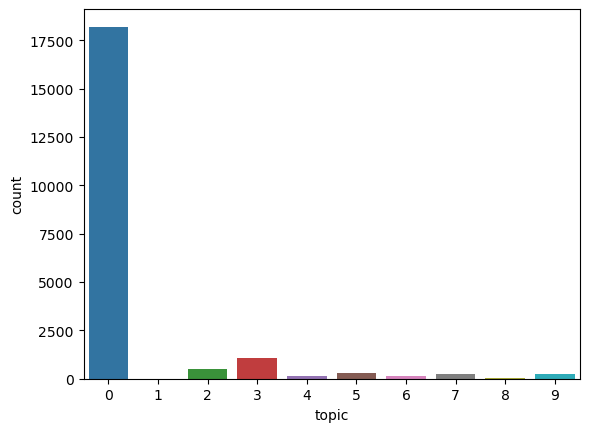

In [67]:
topics_df = pd.DataFrame({'topic' : lsa_categories, 'count' : lsa_counts})
sns.barplot(x=topics_df['topic'], y = topics_df['count'])
plt.show()

In [ ]:
vect.get_feature_names_out

In [69]:
vocab = vect.get_feature_names_out()

for i, comp in enumerate(lsa_model.components_):
    vocab_comp = zip(vocab, comp)
    sorted_words = sorted(vocab_comp, key= lambda x:x[1], reverse=True)[:10]
    print("Topic "+str(i)+": ")
    for t in sorted_words:
        print(t[0],end=" ")
    print("\n")

Topic 0: 
xxxx chase account credit card xxxxxxxx bank payment would charge 

Topic 1: 
xxxx property loan xxxxxxxxxxxx sale foreclosure court attorney title lien 

Topic 2: 
credit card report inquiry payment late score hard interest reporting 

Topic 3: 
payment loan mortgage late modification home interest xxxxxxxx month rate 

Topic 4: 
account credit report inquiry check reporting hard bank payment closed 

Topic 5: 
xxxxxxxx inquiry report hard loan letter information dispute mortgage claim 

Topic 6: 
xxxxxxxx payment account late balance charge statement fee made charged 

Topic 7: 
check card inquiry credit told deposited would said deposit called 

Topic 8: 
xxxxxxxx card closed account offer bonus point opened balance applied 

Topic 9: 
interest charge check balance loan fee rate bank charged overdraft 



In [70]:
def get_mean_topic_vectors(keys, two_dim_vectors, n_topics):
    '''
    returns a list of centroid vectors from each predicted topic category
    '''
    mean_topic_vectors = []
    for t in range(n_topics):
        articles_in_that_topic = []
        for i in range(len(keys)):
            if keys[i] == t:
                articles_in_that_topic.append(two_dim_vectors[i])    
        
        articles_in_that_topic = np.vstack(articles_in_that_topic)
        mean_article_in_that_topic = np.mean(articles_in_that_topic, axis=0)
        mean_topic_vectors.append(mean_article_in_that_topic)
    return mean_topic_vectors

In [71]:
colormap = np.array([
    "#1f77b4", "#aec7e8", "#ff7f0e", "#ffbb78", "#2ca02c",
    "#98df8a", "#d62728", "#ff9896", "#9467bd", "#c5b0d5",
    "#8c564b", "#c49c94", "#e377c2", "#f7b6d2", "#7f7f7f",
    "#c7c7c7", "#bcbd22", "#dbdb8d", "#17becf", "#9edae5" ])
colormap = colormap[:10]

In [73]:
from sklearn.manifold import TSNE
tsne_lsa_model = TSNE(n_components=2, perplexity=50, learning_rate=100, 
                        n_iter=2000, verbose=1, random_state=0, angle=0.75)
tsne_lsa_vectors = tsne_lsa_model.fit_transform(lsa_top)

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 20871 samples in 0.028s...
[t-SNE] Computed neighbors for 20871 samples in 6.234s...
[t-SNE] Computed conditional probabilities for sample 1000 / 20871
[t-SNE] Computed conditional probabilities for sample 2000 / 20871
[t-SNE] Computed conditional probabilities for sample 3000 / 20871
[t-SNE] Computed conditional probabilities for sample 4000 / 20871
[t-SNE] Computed conditional probabilities for sample 5000 / 20871
[t-SNE] Computed conditional probabilities for sample 6000 / 20871
[t-SNE] Computed conditional probabilities for sample 7000 / 20871
[t-SNE] Computed conditional probabilities for sample 8000 / 20871
[t-SNE] Computed conditional probabilities for sample 9000 / 20871
[t-SNE] Computed conditional probabilities for sample 10000 / 20871
[t-SNE] Computed conditional probabilities for sample 11000 / 20871
[t-SNE] Computed conditional probabilities for sample 12000 / 20871
[t-SNE] Computed conditional probabilities for sa

In [79]:
from wordcloud import WordCloud
def draw_word_cloud(index, model):
    imp_words_topic=""
    comp=model.components_[index]
    vocab_comp = zip(vocab, comp)
    sorted_words = sorted(vocab_comp, key= lambda x:x[1], reverse=True)[:50]
    for word in sorted_words:
        imp_words_topic=imp_words_topic+" "+word[0]

    wordcloud = WordCloud(width=600, height=400).generate(imp_words_topic)
    plt.figure( figsize=(5,5))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.tight_layout()
    plt.show()


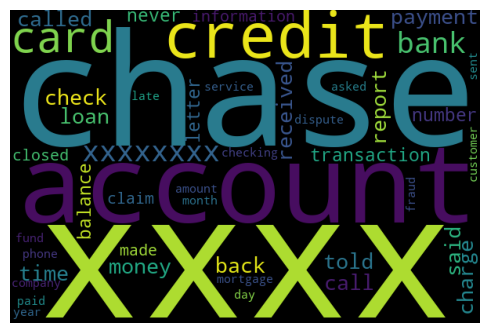

In [80]:
draw_word_cloud(0, lsa_model)

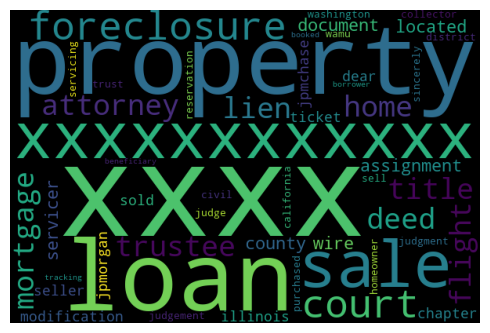

In [81]:
draw_word_cloud(1, lsa_model)

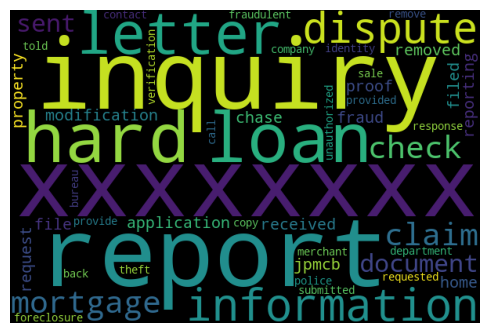

In [82]:
draw_word_cloud(5, lsa_model)

In [83]:
vectorizer = CountVectorizer(analyzer='word',       
                             min_df=10,# minimum reqd occurences of a word 
                             stop_words='english',             # remove stop words
                             lowercase=True,                   # convert all words to lowercase
                             token_pattern='[a-zA-Z0-9]{3,}')  # num chars > 3
data_vectorized = vectorizer.fit_transform(df_clean['lemmatized_complaints'])

In [84]:
lda_model = LatentDirichletAllocation(n_components=20,               # Number of topics
                                      max_iter=10,               # Max learning iterations
                                      learning_method='online',   
                                      random_state=100,          # Random state
                                      batch_size=128,            # n docs in each learning iter
                                      evaluate_every = -1,       # compute perplexity every n iters, default: Don't
                                      n_jobs = -1,               # Use all available CPUs
                                     )
lda_output = lda_model.fit_transform(data_vectorized)
print(lda_model) 

LatentDirichletAllocation(learning_method='online', n_components=20, n_jobs=-1,
                          random_state=100)


In [85]:
# Log Likelyhood: Higher the better
print("Log Likelihood: ", lda_model.score(data_vectorized))
# Perplexity: Lower the better. Perplexity = exp(-1. * log-likelihood per word)
print("Perplexity: ", lda_model.perplexity(data_vectorized))
# See model parameters
print(lda_model.get_params())

Log Likelihood:  -13327032.479739727
Perplexity:  582.4120663435309
{'batch_size': 128, 'doc_topic_prior': None, 'evaluate_every': -1, 'learning_decay': 0.7, 'learning_method': 'online', 'learning_offset': 10.0, 'max_doc_update_iter': 100, 'max_iter': 10, 'mean_change_tol': 0.001, 'n_components': 20, 'n_jobs': -1, 'perp_tol': 0.1, 'random_state': 100, 'topic_word_prior': None, 'total_samples': 1000000.0, 'verbose': 0}


In [ ]:
# Define Search Param
search_params = {'n_components': [10, 15, 20], 'learning_decay': [.5, .7, .9]}
# Init the Model
lda = LatentDirichletAllocation(max_iter=5, learning_method='online', learning_offset=50.,random_state=0)
# Init Grid Search Class
model = GridSearchCV(lda, param_grid=search_params)
# Do the Grid Search
model.fit(data_vectorized)

In [ ]:
# Best Model
best_lda_model = model.best_estimator_
# Model Parameters
print("Best Model's Params: ", model.best_params_)
# Log Likelihood Score
print("Best Log Likelihood Score: ", model.best_score_)
# Perplexity
print("Model Perplexity: ", best_lda_model.perplexity(data_vectorized))


In [ ]:
lda_output = best_lda_model.transform(data_vectorized)

In [ ]:
documet_topic_lda = topics_document(lda_output, n_topics=10, data=df_clean['lemmatized_complaints'])
documet_topic_lda

In [ ]:
lda_keys = get_keys(lda_output)
lda_categories, lda_counts = keys_to_counts(lda_keys)

topics_df_lda = pd.DataFrame({'topic' : lda_categories, 'count' : lda_counts})
sns.barplot(x=topics_df_lda['topic'], y = topics_df_lda['count'])
plt.show()

In [ ]:
def show_topics(vectorizer=vectorizer, lda_model=lda_model, n_words=10):
    keywords = np.array(vectorizer.get_feature_names_out())
    topic_keywords = []
    for topic_weights in lda_model.components_:
        top_keyword_locs = (-topic_weights).argsort()[:n_words]
        topic_keywords.append(keywords.take(top_keyword_locs))
    return topic_keywords
topic_keywords = show_topics(vectorizer=vectorizer, lda_model=best_lda_model, n_words=15)
# Topic - Keywords Dataframe
df_topic_keywords = pd.DataFrame(topic_keywords)
df_topic_keywords.columns = ['Word '+str(i) for i in range(df_topic_keywords.shape[1])]
df_topic_keywords.index = ['Topic '+str(i) for i in range(df_topic_keywords.shape[0])]
df_topic_keywords